# Twitter Topic Modeling

## EDA

### Loading the Dataset

In [76]:
from google.colab import data_table
data_table.enable_dataframe_formatter()

In [5]:
# Mount Google Drive
from google.colab import drive
drive.mount('/content/drive', force_remount=True)

import os

# Define the destination folder in Google Drive
folder_path = '/content/drive/My Drive/ColabFiles/twitter-topic-modeling/'

Mounted at /content/drive


In [78]:
import pandas as pd

# Load the CSV file
file_path = 'data-1716191272369.csv'
data = pd.read_csv(folder_path + file_path)

In [79]:
# Get the number of rows
total_tweets = data.shape[0]
print(f"Number of rows: {total_tweets}")

# Take a sample of 100 rows
sample_data = data.sample(n=100)
sample_data[['id', 'text']]

Number of rows: 148893


,id,text
45597,1741744898145989105,"@gilad_sharon מר שרון הצעיר\nסתום את הפה קצת, ..."
1113,1741582199894294632,מאוד מצחיק חמאס
70958,1741802035370967462,@YahavYonatan מה דעתך?
132114,1741911314992091221,@Josinive כל האפשרויות על השולחן. בת13 תכעס במ...
11074,1741609066416206123,אלקי המוסר שיחטפו מהם אולי הם ידברו בערבית. ר...
...,...,...
77335,1741815301593796989,@atudai_ וואלה הכריזה הייתי נוראית לא שמעתי כל...
85280,1741832616658030821,"@avniyayin @EllaTravelsLove מה אני אגיד, מפריע..."
127383,1741902770242793868,אמממ
2001,1741583911497416940,2024 נפתחה במטח כבוד של הנאצים לשותף שהביא אות...


We have a dataset containing 150,000 Hebrew tweets. From an initial glance, it appears that most of these tweets are about politics.

After we loaded the dataset and saw a sample of it, before running to use some LLMs and big models, let's make some key insights from the dataset.

### Chapter 1: Basic Strings Analysis
#### Insight 1.1: Character Count in Tweets
Count the number of characters in each tweet and plot a histogram.



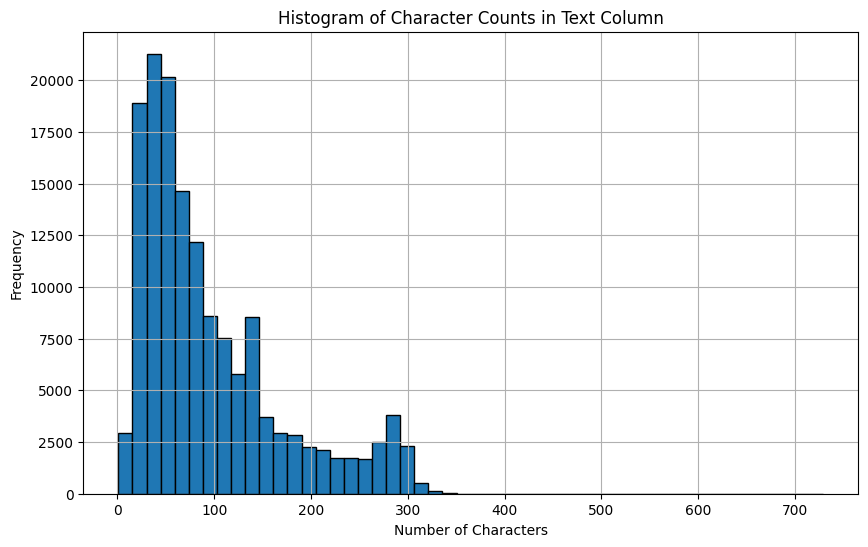

In [8]:
import pandas as pd
import matplotlib.pyplot as plt

# Count the number of characters in the text column
data['char_count'] = data['text'].apply(len)

# Plot a histogram of the character counts
plt.figure(figsize=(10, 6))
plt.hist(data['char_count'], bins=50, edgecolor='k')
plt.title('Histogram of Character Counts in Text Column')
plt.xlabel('Number of Characters')
plt.ylabel('Frequency')
plt.grid(True)
plt.show()

#### Insight 1.2: Most Frequently Used Words
Find the most frequently used words across all tweets.

In [9]:
from collections import Counter
import string

# Tokenize the tweets and remove punctuation
def tokenize(text):
    translator = str.maketrans('', '', string.punctuation)
    return text.translate(translator).split()

all_words = data['text'].apply(tokenize)
all_words = [word.lower() for sublist in all_words for word in sublist]

# Count the occurrences of each word
word_counts = Counter(all_words)
most_common_words = word_counts.most_common(10)

# Display the most common words
print("Most common words:")
for word, count in most_common_words:
    print(f"{word}: {count}")

Most common words:
לא: 49360
את: 46525
זה: 29568
של: 29180
על: 25425
מה: 15347
אני: 13381
כל: 12403
עם: 12396
אתה: 11788


As we can see, we got Hebrew stopwords, which does not helps us too much. We can say that the word "לא" seems to be popular, which indicates a high frequency of negations in the dataset.

### Chapter 2: Mention Analysis
#### Insight 2.1: Number of @Mentions

Count the number of @mentions in each tweet and in general.

In [10]:
import re

# Count the number of @mentions in each tweet
data['num_mentions'] = data['text'].apply(lambda x: len(re.findall(r'@\w+', x)))

# Display the first few rows to verify the results
data[['text', 'num_mentions']].sample(100)

,text,num_mentions
146977,@michalagmon2 הצילו מליוני אזרחים ברגע האחרון....,1
37919,@AGvaryahu מי עושה דברים כאלו?\nפלאסטינאצים ht...,1
100866,"@roni_eitan אני נזכר שבמלחמת לבנון השנייה, המ""...",1
137442,@lielillsl @EitanBenZvi @JoshBreiner גם הנאצים...,3
58785,@OriyaShilat כמו שצריך,1
...,...,...
107692,@YairSulimani @Now14Israel אתה ביביסט סורר תקש...,2
109772,@MichaStocks @N12News @amit_segal מיכה. אתה נד...,3
69340,@n_dekel @Wait_for_it7 נוי סופסוף את מצטרפת לש...,2
29856,@yairlapid סתום ת'פה,1


In [11]:
import pandas as pd
import re

# Calculate KPIs
tweets_with_mentions = len(data[data['num_mentions'] > 0])
tweets_without_mentions = total_tweets - tweets_with_mentions
mentions_percentage = (tweets_with_mentions / total_tweets) * 100

# Display the KPIs
print(f"Total number of mentions: {total_tweets}")
print(f"Tweets with mentions: {tweets_with_mentions} ({mentions_percentage:.2f}%)")
print(f"Tweets without mentions: {tweets_without_mentions} ({100 - mentions_percentage:.2f}%)")

Total number of mentions: 148893
Tweets with mentions: 117778 (79.10%)
Tweets without mentions: 31115 (20.90%)


#### Insight 2.2: Most Popular @Mentions
Identify the most popular @mentions in the tweets.

In [12]:
from collections import Counter
import re

# Extract all mentions
all_mentions = data['text'].apply(lambda x: re.findall(r'@\w+', x))
all_mentions = [mention for sublist in all_mentions for mention in sublist]

# Count the occurrences of each mention
mention_counts = Counter(all_mentions)

# Convert the mention counts to a DataFrame
mention_counts_df = pd.DataFrame(mention_counts.items(), columns=['mention', 'count'])

# Sort the DataFrame by count in descending order
mention_counts_df = mention_counts_df.sort_values(by='count', ascending=False)

# Display the DataFrame
mention_counts_df.head(10)

,mention,count
3,@YinonMagal,2298
461,@itamarbengvir,1862
11,@netanyahu,1391
204,@mennyassyag,1323
822,@BenCaspit,1165
0,@berale_crombie,1152
16,@ishaycoen,1069
216,@ShikmaBressler,1054
29,@yairlapid,1048
259,@JoshBreiner,991


#### Insight 2.3: Top 10 Words with Most Popular Mentions
We have identified the top 100 mentions and extracted the top 10 words associated with each popular mention.

In [13]:
from collections import defaultdict, Counter
import re

top_mentions_df = mention_counts_df.head(100)

# Initialize a dictionary to store words associated with each mention
mention_words = defaultdict(list)

# Extract words associated with each mention
for tweet in data['text']:
    mentions = re.findall(r'@\w+', tweet)
    words = re.findall(r'\b\w+\b', tweet)
    for mention in mentions:
        mention_words[mention].extend(words)

# Calculate the top 10 words for each mention
mention_top_words = {mention: Counter([word.lower() for word in words]).most_common(10)
                     for mention, words in mention_words.items()}

# Filter to include only the top 100 mentions
top_mention_top_words = {mention: mention_top_words[mention] for mention in top_mentions_df['mention']}

# Convert to DataFrame for better readability
top_mention_top_words_df = pd.DataFrame.from_dict(top_mention_top_words, orient='index')
top_mention_top_words_df.columns = [f'Top {i+1} Word' for i in range(10)]

# Display the table
top_mention_top_words_df.head(10)

,Top 1 Word,Top 2 Word,Top 3 Word,Top 4 Word,Top 5 Word,Top 6 Word,Top 7 Word,Top 8 Word,Top 9 Word,Top 10 Word
@YinonMagal,"(yinonmagal, 2302)","(לא, 732)","(את, 608)","(של, 398)","(על, 393)","(זה, 372)","(אתה, 306)","(https, 271)","(t, 271)","(co, 270)"
@itamarbengvir,"(itamarbengvir, 1866)","(את, 633)","(לא, 610)","(אתה, 494)","(זה, 415)","(על, 308)","(מה, 270)","(של, 265)","(לך, 238)","(כל, 204)"
@netanyahu,"(netanyahu, 1405)","(את, 697)","(לא, 391)","(המשפט, 287)","(בית, 283)","(על, 280)","(https, 268)","(t, 268)","(co, 268)","(של, 268)"
@mennyassyag,"(mennyassyag, 1329)","(לא, 538)","(את, 490)","(אתה, 297)","(על, 286)","(של, 245)","(זה, 241)","(כל, 197)","(מה, 180)","(עם, 143)"
@BenCaspit,"(bencaspit, 1165)","(את, 473)","(לא, 403)","(של, 310)","(על, 266)","(זה, 240)","(אתה, 189)","(מה, 155)","(t, 124)","(https, 123)"
@berale_crombie,"(berale_crombie, 1152)","(לא, 439)","(את, 351)","(אתה, 267)","(על, 225)","(של, 196)","(זה, 186)","(לך, 127)","(מה, 121)","(https, 107)"
@ishaycoen,"(ishaycoen, 1071)","(לא, 373)","(את, 324)","(אתה, 246)","(של, 233)","(על, 201)","(זה, 194)","(מה, 165)","(לך, 98)","(הוא, 90)"
@ShikmaBressler,"(shikmabressler, 1054)","(את, 551)","(לא, 412)","(של, 193)","(על, 181)","(זה, 161)","(מה, 126)","(עם, 115)","(t, 106)","(https, 105)"
@yairlapid,"(yairlapid, 1054)","(את, 338)","(אתה, 328)","(לא, 304)","(של, 204)","(על, 171)","(זה, 148)","(לך, 132)","(t, 130)","(https, 128)"
@JoshBreiner,"(joshbreiner, 991)","(לא, 325)","(את, 306)","(זה, 213)","(של, 195)","(על, 153)","(rt, 145)","(אין, 120)","(אתה, 109)","(מה, 107)"


We got mostly garbage top-words that not that helps us in this insight:
- **Hebrew Stopwords**: Common words that do not add significant meaning to the sentences. Once again the word "לא" is popular.
- **URLs**: Links to websites. Some accounts are being mentioned a lot with links, mainly @YinonMagal, @itamarbengvir and @netanyahu.
- **Mentions**: References to other accounts.
</br ></br >

To extend this analysis, we can explore:

- **Account Similarity**: Analyze accounts based on the common top-words associated with their mentions.
- **Account Profiling**: Determine what an account is most related to and what people are saying about it based on the top-words per account. We can feed this data into a LLM to gain deeper insights.
- **Sentiment Analysis**: Assess the sentiment of mentions to understand whether the mentions are positive, negative, or neutral.

I can conduct an interesting analysis here by identifying the most frequently occurring words associated with each person. Then, we can feed this data into a LLM to generate a sentence about each individual. This approach could significantly benefit our product and align with the company's goals.

### Chapter 3: URL Analysis
#### Insight 3.1: Tweets with URLs

Count the number of tweets containing URLs and calculate the percentage.

In [14]:
# Check for URLs in each tweet
data['has_url'] = data['text'].apply(lambda x: bool(re.search(r'http[s]?://', x)))

# Calculate the total number of tweets with and without URLs
tweets_with_url = data['has_url'].sum()
tweets_without_url = total_tweets - tweets_with_url
url_percentage = (tweets_with_url / total_tweets) * 100

# Display the KPI
print(f"Total number of tweets: {total_tweets}")
print(f"Tweets with URL: {tweets_with_url} ({url_percentage:.2f}%)")
print(f"Tweets without URL: {tweets_without_url} ({100 - url_percentage:.2f}%)")

Total number of tweets: 148893
Tweets with URL: 17636 (11.84%)
Tweets without URL: 131257 (88.16%)


#### Insight 3.2: Top Websites in Tweets
Extract top 15 websites by extracting and counting the domains from the URLs in the tweets

In [15]:
from urllib.parse import urlparse

# Extract URLs from each tweet
data['urls'] = data['text'].apply(lambda x: re.findall(r'http[s]?://\S+', x))

# Extract the domain from each URL
data['domains'] = data['urls'].apply(lambda urls: [urlparse(url).netloc for url in urls])

# Flatten the list of domains and count the occurrences
all_domains = [domain for sublist in data['domains'] for domain in sublist]
domain_counts = Counter(all_domains)

# Convert the domain counts to a DataFrame
domain_counts_df = pd.DataFrame(domain_counts.items(), columns=['domain', 'count'])

# Sort the DataFrame by count in descending order and take the top 15
top_domains_df = domain_counts_df.sort_values(by='count', ascending=False).head(15)

# Display the DataFrame
top_domains_df

,domain,count
0,t.co,18353
6,…,19
2,t.…,18
7,t.co…,9
5,t…,7
1,t.c…,4
3,www.news-,1
4,www.ice.co.il,1


I don't use Twitter very often, so I wasn't aware that links are shortened with [t.co](https://t.co):

> Twitter uses the t.co domain as part of a service to protect users from harmful activity, to provide value for the developer ecosystem, and as a quality signal for surfacing relevant, interesting Tweets.

So the URLs inside the tweets do not provide us insights. One solution that might help is to access these websites (with webscrape methods) and gain some insights from their content. This is outside the current scope, and we have only 12% of the tweets with URLs so we will keep going.




### Chapter 4: Hashtag Analysis
#### Insight 4.1: Number of Hashtags

Count the number of hashtags in each tweet and plot a histogram.

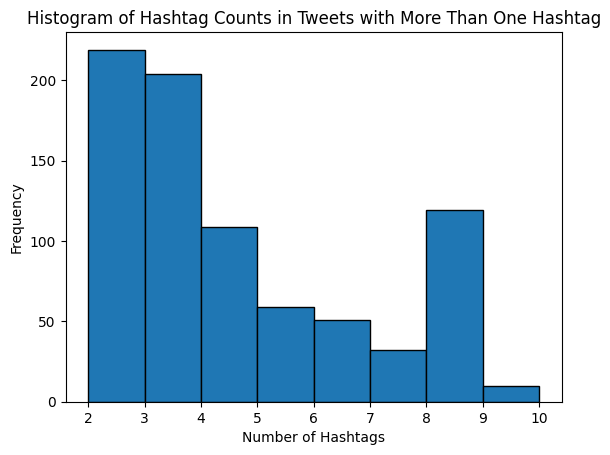

In [16]:
# Count the number of hashtags in each tweet
data['num_hashtags'] = data['text'].apply(lambda x: len(re.findall(r'#\w+', x)))

# Filter tweets with more than one hashtag
filtered_data = data[data['num_hashtags'] >= 1]

# Plot a histogram of the hashtag counts for tweets with more than one hashtag
plt.figure()
plt.hist(filtered_data['num_hashtags'], bins=[2, 3, 4, 5, 6, 7, 8, 9, 10], edgecolor='k')
plt.title('Histogram of Hashtag Counts in Tweets with More Than One Hashtag')
plt.xlabel('Number of Hashtags')
plt.ylabel('Frequency')
plt.show()

Given the small amount of tweets with hashtags, it seems that the Israelis do not use them in their tweets.

## Data Cleaning

In [ ]:
import pandas as pd

# Load the CSV file
file_path = folder_path + 'lemmatized_tweets.csv'
tweets_df = pd.read_csv(file_path)

# Display the first few rows of the dataframe
tweets_df.head()

Cleaning Hebrew tweets is more challenging than English tweets. From my experience, there are no well-known libraries that provide convenient cleaning and normalization for Hebrew. There is unique slang, and generally, not many people use NLP methods for Hebrew language processing.

I decided to approach this step by step, allowing for flexibility. I created a class called `HebrewTweetProcessor` to handle cleaning and extraction tasks.

My main challenge is deciding what to keep and what to remove:
- Do I want to remove emojis? Or should I "translate" them into words?
- Should I remove mentions?
- Unique Hebrew chars:
```
״ and not "
׳ and not '
־ and not -
```

I decided to simply start working on it and learn along the way.

### Building `HebrewTweetProcessor` Class

In [18]:
class HebrewTweetProcessor:
    def __init__(self, stopwords):
        self.stopwords = stopwords

    def normalize_text(self, text):
        """
        Normalize the text by converting to lowercase and removing Hebrew diacritics (ניקוד).
        Example:
        Input: "שָׁלוֹם עליכם!"
        Output: "שלום עליכם"
        """
        # Convert to lowercase
        text = text.lower()
        # Remove Hebrew diacritics
        text = re.sub(r'[\u0591-\u05C7]', '', text)
        return text

    def remove_noise(self, text):
        """
        Remove repeated characters that appear more than twice.
        Example:
        Input: "היייי לכולם!!!"
        Output: "היי לכולם!"
        """
        text = re.sub(r'(.)\1{2,}', r'\1', text)
        return text

    def remove_mentions(self, text):
        """
        Remove mentions (usernames starting with @).
        Example:
        Input: "@motiszuszan1958 עמית לחקירת שב״כ מי המדליף."
        Output: " עמית לחקירת שב״כ מי המדליף."
        """
        text = re.sub(r'@\w+', '', text)
        return text

    def remove_links(self, text):
        """
        Remove URLs from the text.
        Example:
        Input: "Check this out http://example.com"
        Output: "Check this out "
        """
        text = re.sub(r'http\S+|www\S+|https\S+', '', text, flags=re.MULTILINE)
        return text

    def replace_hebrew_specific_chars(self, text):
        """
        Replace Hebrew-specific punctuation marks with English equivalents.
        Example:
        Input: 'בג״צ הוא גוף משפטי'
        Output: 'בג"צ הוא גוף משפטי'
        """
        text = text.replace('״', '"')
        text = text.replace('׳', "'")
        text = text.replace('־', '-')
        return text

    def replace_punctuation_inside_words(self, text):
        """
        Remove non-Hebrew/non-English punctuation inside words.
        Example:
        Input: "בג״צ הוא גוף משפטי"
        Output: "בגצ הוא גוף משפטי"
        """
        text = re.sub(r'(\w)[^a-zA-Z\u0590-\u05FF\s](\w)', r'\1\2', text)
        return text

    def replace_punctuation_outside_words(self, text):
        """
        Replace punctuation outside words with spaces.
        Example:
        Input: "זהו טקסט, עם הרבה סימני פיסוק!"
        Output: "זהו טקסט עם הרבה סימני פיסוק "
        """
        text = re.sub(r'[^a-zA-Z\u0590-\u05FF\s]', ' ', text)
        return text

    def remove_emojis(self, text):
        """
        Replace emojis with spaces.
        Example:
        Input: "שלום 😊"
        Output: "שלום "
        """
        text = re.sub(r'[^\w\s,]', ' ', text)
        return text

    def remove_special_characters(self, text):
        """
        Replace special characters with spaces, keeping Hebrew letters.
        Example:
        Input: "היי! מה קורה?"
        Output: "היי מה קורה"
        """
        text = re.sub(r'[^\w\s\u0590-\u05FF]', ' ', text)
        return text

    def remove_stopwords(self, text):
        """
        Remove Hebrew stopwords.
        Example:
        Input: "זהו טקסט לדוגמה"
        Output: "טקסט לדוגמה"
        """
        return ' '.join([word for word in text.split() if word not in self.stopwords])

    def normalize_spaces(self, text):
        """
        Normalize spaces by replacing multiple spaces with a single space and stripping leading/trailing spaces.
        Example:
        Input: "שלום   עליכם!"
        Output: "שלום עליכם!"
        """
        text = re.sub(r'\s+', ' ', text).strip()
        return text

    def remove_english_letters(self, text):
        """
        Remove English letters from the text.
        Example:
        Input: "שלום world"
        Output: "שלום "
        """
        text = re.sub(r'[a-zA-Z]', '', text)
        return text

    def process_tweet(self, tweet):
        """
        Process a single tweet through all cleaning steps.
        """
        tweet = self.replace_hebrew_specific_chars(tweet)
        tweet = self.normalize_text(tweet)
        tweet = self.remove_links(tweet)
        tweet = self.remove_mentions(tweet)
        tweet = self.replace_punctuation_inside_words(tweet)
        tweet = self.replace_punctuation_outside_words(tweet)
        tweet = self.remove_emojis(tweet)
        tweet = self.remove_special_characters(tweet)
        tweet = self.remove_noise(tweet)
        tweet = self.remove_stopwords(tweet)
        tweet = self.normalize_spaces(tweet)
        tweet = self.remove_english_letters(tweet)
        return tweet

In [19]:
import csv

# Sample tweet with punctuation
sample_tweet = "@hezizur @ShemuelMeir אֲשֶׁר לֹא־נוֹעַז בְּנַפְשׁוֹ מֵעוֹלָם לָצֵאת עִם־עַמּוֹ.     לַעֲרֹךְ מִלְחָמָה,????? לְהֵחָלֵץ, כִּי נוֹרָא הַדָּבָר בְּעֵינֶיךָ כַּמָּוֶת. יוֹתֵר טוֹב בְּעֵינֶיךָ לִגְזֹל אֶשְׁכָּרִים בְּמַחֲנֵה מֶלֶךְ אוֹכֵל־עַמּוֹ https://t.co, נָטַשׁ זֶה־כַּמָּה אֶת־גִּזְעוֹ האיליאדה. 🤩🤩🤩🤩 הומרוס (טשרניחובסקי)."

# Load stopwords from file
with open(folder_path + 'he-stopwords.csv', 'r', encoding='utf-8') as file:
    reader = csv.reader(file)
    hebrew_stopwords = set(row[0] for row in reader if row)

# Create an instance of the processor
processor = HebrewTweetProcessor(hebrew_stopwords)

# Process the sample tweet
cleaned_tweet = processor.process_tweet(sample_tweet)

# Print the result
print("Original Tweet:", sample_tweet)
print("Cleaned Tweet:", cleaned_tweet)

Original Tweet: @hezizur @ShemuelMeir אֲשֶׁר לֹא־נוֹעַז בְּנַפְשׁוֹ מֵעוֹלָם לָצֵאת עִם־עַמּוֹ.     לַעֲרֹךְ מִלְחָמָה,????? לְהֵחָלֵץ, כִּי נוֹרָא הַדָּבָר בְּעֵינֶיךָ כַּמָּוֶת. יוֹתֵר טוֹב בְּעֵינֶיךָ לִגְזֹל אֶשְׁכָּרִים בְּמַחֲנֵה מֶלֶךְ אוֹכֵל־עַמּוֹ https://t.co, נָטַשׁ זֶה־כַּמָּה אֶת־גִּזְעוֹ האיליאדה. 🤩🤩🤩🤩 הומרוס (טשרניחובסקי).
Cleaned Tweet: לאנועז בנפשו מעולם לצאת עםעמו לערך מלחמה להחלץ נורא הדבר בעיניך טוב בעיניך לגזל אשכרים במחנה מלך אוכלעמו נטש זהכמה אתגזעו האיליאדה הומרוס טשרניחובסקי


As we can see, the `HebrewTweetProcessor` class is performing its function well (besides small bug in words with special characters inside them), allowing us to continue our work (until further changes are required 😉).








### Running the Cleaning Process
Our next step is to loop through the dataset and clean it. I used A100 and it ran for about 20s.

In [20]:
!pip install tqdm

In [21]:
import csv
from multiprocessing import Pool, cpu_count
from tqdm import tqdm

def process_tweet_wrapper(args):
    processor, tweet = args
    return processor.process_tweet(tweet)

def main():
    # Load stopwords from file
    with open(folder_path + 'he-stopwords.csv', 'r', encoding='utf-8') as file:
        reader = csv.reader(file)
        stopwords = set(row[0] for row in reader if row)

    processor = HebrewTweetProcessor(hebrew_stopwords)

    # Prepare data for multiprocessing
    tweets = data['text'].tolist()
    args = [(processor, tweet) for tweet in tweets]

    # Use multiprocessing to process tweets with a progress bar
    with Pool(cpu_count()) as pool:
        cleaned_tweets = list(tqdm(pool.imap(process_tweet_wrapper, args), total=len(tweets)))

    data['cleaned_tweet'] = cleaned_tweets

    # Save the cleaned data to a new CSV file
    data[['text', 'cleaned_tweet']].to_csv(folder_path + 'cleaned_tweets.csv', index=False)

    print("Cleaning complete. Processed tweets saved to 'cleaned_tweets.csv'.")

if __name__ == '__main__':
    main()

data[['text', 'cleaned_tweet']].sample(100)

100%|██████████| 148893/148893 [00:22<00:00, 6608.88it/s]


Cleaning complete. Processed tweets saved to 'cleaned_tweets.csv'.


,text,cleaned_tweet
97228,@BarashiKinneret @Efratrayten1 תקשיבי כפרה..לא...,תקשיבי כפרה לאנדאן עשתה לך טוב
17746,@TomWeinerParty וואווווווו,וואו
18767,@bogie_yaalon הודתה שאתה שקרן שפל והפסדת במשפט...,הודתה שאתה שקרן שפל והפסדת במשפט תתבקש סליחה ו...
11689,@ARotmensh הפוך גוטה.\nהשקטים הם המסוכנים.\nלט...,הפוך גוטה השקטים המסוכנים לטלי גוטליב אין פרומ...
7286,@netanelgla זה מה שנשאר\nרק כמה רגעים\nהרבה בד...,שנשאר רגעים בדמיון בחיים בנתניהו
...,...,...
45239,@smile_love_food מצפה לזה 😘,מצפה לזה
43064,@radio103fm @usegal מי תקף ? האלוף זיו שטען שח...,תקף האלוף זיו שטען שחמאס הארגון הפחות גרוע הבנתי
5010,@roi_zaga לפעמים אי אפשר לתאר רגש במילים\nאז א...,לפעמים אפשר לתאר רגש במילים אז ממעיט בהן
141828,@OmerCohenSkali @shimritmeir הבעיה זאת לא הקלפ...,הבעיה הקלפי הבעיה הפוליטיקאים פופוליסטים שמוכר...


### Small Visualization for Fun
After we cleaned the data we can create word cloud to see the popular words 🤩

In [22]:
!pip install wordcloud

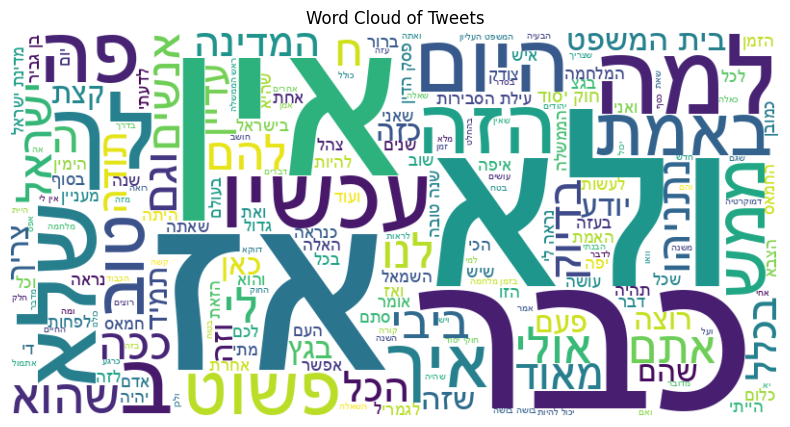

In [23]:
from wordcloud import WordCloud
import matplotlib.pyplot as plt
import pandas as pd

# Get all words from cleaned data
text = ' '.join(data['cleaned_tweet'])

# Specify the font path which support he
font_path = folder_path + 'Arial.ttf'

# Generate the word cloud
wordcloud = WordCloud(width=800, height=400, background_color='white', font_path=font_path).generate(text)

# Plot the word cloud
plt.figure(figsize=(10, 5))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud of Tweets')
plt.show()

As we can see, we can refine the stopwords list, and make it catch more words.

### Hebrew Lemmatization with dicta-il/dictabert-lex
I employed the dicta-il/dictabert-lex model, a specialized version of dicta-il/dictabert fine-tuned for Hebrew sentence lemmatization. Initially, I did not utilize this model, but after observing its advantages, I decided to adopt it.

In [24]:
!pip install transformers safetensors

First, I had need to import the necessary libraries from the `transformers` library and `PyTorch`. We load the pre-trained tokenizer and model `dicta-il/dictabert-lex` using `AutoTokenizer` and `AutoModel`. The model is then moved to the GPU if available, and switched to evaluation mode.

In [25]:
from transformers import AutoModel, AutoTokenizer
import torch

# Load the tokenizer and model
tokenizer = AutoTokenizer.from_pretrained('dicta-il/dictabert-lex')
model = AutoModel.from_pretrained('dicta-il/dictabert-lex', trust_remote_code=True)

# Move model to GPU
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model.to(device)

# Switch model to evaluation mode
model.eval()

/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:89: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


tokenizer_config.json:   0%|          | 0.00/1.35k [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/1.50M [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/3.58M [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/695 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/733 [00:00<?, ?B/s]

BertForLexPrediction.py:   0%|          | 0.00/1.65k [00:00<?, ?B/s]

A new version of the following files was downloaded from https://huggingface.co/dicta-il/dictabert-lex:
- BertForLexPrediction.py
. Make sure to double-check they do not contain any added malicious code. To avoid downloading new versions of the code file, you can pin a revision.


model.safetensors:   0%|          | 0.00/738M [00:00<?, ?B/s]

BertForLexPrediction(
  (bert): BertModel(
    (embeddings): BertEmbeddings(
      (word_embeddings): Embedding(128000, 768, padding_idx=0)
      (position_embeddings): Embedding(512, 768)
      (token_type_embeddings): Embedding(2, 768)
      (LayerNorm): LayerNorm((768,), eps=1e-12, elementwise_affine=True)
      (dropout): Dropout(p=0.1, inplace=False)
    )
    (encoder): BertEncoder(
      (layer): ModuleList(
        (0-11): 12 x BertLayer(
          (attention): BertAttention(
            (self): BertSdpaSelfAttention(
              (query): Linear(in_features=768, out_features=768, bias=True)
              (key): Linear(in_features=768, out_features=768, bias=True)
              (value): Linear(in_features=768, out_features=768, bias=True)
              (dropout): Dropout(p=0.1, inplace=False)
            )
            (output): BertSelfOutput(
              (dense): Linear(in_features=768, out_features=768, bias=True)
              (LayerNorm): LayerNorm((768,), eps=1e-12, ele

I used a sample sentence in Hebrew. This sentence is tokenized and converted to tensor format.

Using the model, I predicted the output logits. These logits are then used to determine the predicted tokens. I converted these token IDs back to their corresponding words and print the results. The output includes both the original tokens and their predicted lemmatized forms.

In [26]:
# Sample sentence
sentence = 'בשנת 1948 השלים אפרים קישון את לימודיו בפיסול מתכת ובתולדות האמנות והחל לפרסם מאמרים הומוריסטיים'

# Tokenize input sentence
inputs = tokenizer(sentence, return_tensors='pt').to(device)

# Predict
with torch.no_grad():
    outputs = model(**inputs)

# Get the predicted tokens
predictions = torch.argmax(outputs.logits, dim=2)

# Convert predictions to lexemes
predicted_lexemes = []
for token, prediction in zip(inputs['input_ids'][0], predictions[0]):
    predicted_lexemes.append((tokenizer.decode([token]), tokenizer.decode([prediction])))

# Print the results
for original, lexeme in predicted_lexemes:
    print(f'{original}: {lexeme}')

[CLS]: .
בשנת: שנה
1948: 1948
השלים: השלים
אפרים: אפרים
קישון: קישון
את: את
לימודיו: לימוד
בפיסול: פיסול
מתכת: מתכת
ובתו: תולדה
##לדו: תולדה
##ת: תולדה
האמנות: אומנות
והחל: החל
לפרסם: פרסם
מאמרים: מאמר
הומוריסטי: הומוריסטי
##ים: הומוריסטי
[SEP]: .


I created a class `HebrewLemmatizer` to make the process of loading the model and tokenizer fast and easy.

I added to the class  an `__init__` method that:
- Initializes the tokenizer and model
- Moving the model to the GPU if available.

The lemmatize method tokenizes a given sentence, uses the model to predict the output, and processes the predictions to return a cleaned-up, lemmatized version of the input sentence.

The special tokens and subwords are removed, and the results are joined into a single string.

In [27]:
from transformers import AutoModel, AutoTokenizer
import torch

class HebrewLemmatizer:
    def __init__(self, model_name='dicta-il/dictabert-lex'):
        """
        Initializes the HebrewLemmatizer class by loading the tokenizer and model.
        """
        self.tokenizer = AutoTokenizer.from_pretrained(model_name)
        self.model = AutoModel.from_pretrained(model_name, trust_remote_code=True)
        self.device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
        self.model.to(self.device)

    def lemmatize(self, sentence):
        """
        Given a sentence, return its lemmatized form.
        """
        # Tokenize the input sentence
        inputs = self.tokenizer(sentence, return_tensors='pt').to(self.device)

        # Predict using the model
        with torch.no_grad():
            outputs = self.model(**inputs)

        # Get the predicted tokens
        predictions = torch.argmax(outputs.logits, dim=2)

        # Convert predictions to lexemes
        predicted_lexemes = []
        for token, prediction in zip(inputs['input_ids'][0], predictions[0]):
            original_word = self.tokenizer.decode([token])
            predicted_lexeme = self.tokenizer.decode([prediction])

            # Skip special tokens and subwords
            if not original_word.startswith("[") and not original_word.startswith("##"):
                predicted_lexemes.append((original_word, predicted_lexeme))

        # Filter out duplicates and special tokens
        final_lexemes = []
        for word, lemma in predicted_lexemes:
            if not (lemma.startswith("[") and lemma.endswith("]")) and not word.startswith("##"):
                final_lexemes.append(lemma)

        return ' '.join(final_lexemes)


# Example usage:
lemmatizer = HebrewLemmatizer()
sentence = 'בשנת 1948 השלים אפרים קישון את לימודיו בפיסול מתכת ובתולדות האמנות והחל לפרסם מאמרים הומוריסטיים'
lemmatized_sentence = lemmatizer.lemmatize(sentence)
print(lemmatized_sentence)

שנה 1948 השלים אפרים קישון את לימוד פיסול מתכת תולדה אומנות החל פרסם מאמר הומוריסטי


I was uncertain whether the lemmatization process should be performed before or after the data cleaning process. The column `Lemmatized Text` shows the results of applying lemmatization directly to the original text, while the `Lemmatized Cleaned Text` column shows the results after first cleaning the text.

In [28]:
import pandas as pd

# Sample 5 rows from the DataFrame
sample_df = data.sample(25)

# Create a new DataFrame to store the original and lemmatized texts
lemmatized_data = {
    'Original Text': sample_df['text'],
    'Lemmatized Text': sample_df['text'].apply(lemmatizer.lemmatize),
    'Cleaned Tweet': sample_df['cleaned_tweet'],
    'Lemmatized Cleaned Text': sample_df['cleaned_tweet'].apply(lemmatizer.lemmatize)
}

# Convert to DataFrame
lemmatized_df = pd.DataFrame(lemmatized_data)

# Display the DataFrame
lemmatized_df

,Original Text,Lemmatized Text,Cleaned Tweet,Lemmatized Cleaned Text
75729,@Shiluz17 צודק סליחה,@ צודק סליחה,צודק סליחה,צודק סליחה
49576,@AdiTraisstaru נשבע אם יש חי אי פעם כלב פאג אנ...,"@ נשבע אם יש חי אי פעם כלב פאג אני נקרא לו "" ת...",נשבע חי פעם כלב פאג קורא תוקף,נשבע חי פעם כלב פאג קורא תוקף
50409,@moshe_primo איגוד השופטים גיבה את ההחלטה שלו ...,@ איגוד שופט גיבה את החלטה של חיפה - ריינה העל...,איגוד השופטים גיבה ההחלטה בחיפהריינה ויגבה ההח...,איגוד שופט גיבה החלטה חיפה גילה החלטה אתמול בח...
81667,אחרי כמה שנים שלא\nהחלפתי סטטוס בוואטסאפ\nמרגי...,אחרי כמה שנה לא החליף סטטוס וואטסאפ מרגיש כמו ...,שנים שלא החלפתי סטטוס בוואטסאפ מרגישה פרידה,שנה לא החליף סטטוס וואטסאפ מרגיש פרדה
23191,@ido_givoni תקרא הדוח שפורסם \nרק תקרא ....,@ נקרא דוח פורסם רק קרא . . . .,תקרא הדוח שפורסם תקרא,נקרא דוח פורסם נקרא
131922,@AidaTuma חוצפה ויהירות היה שהם חדרו לישראל. ע...,@ חוצפה יהירות היי הוא חדר ישראל . הוא משלם על...,חוצפה ויהירות שהם חדרו לישראל עכשעו משלמים החו...,חוצפה יהירות הוא חדר ישראל משלם חוצפה זה סבל ס...
128736,@sivanhakolkalul חיות\nוברון\nיכלו\nלהתאפק \nו...,@ חיות רודה יכולת התאפק ויתר על אגו אחריות על ...,חיות וברון יכלו להתאפק ולוותר האגו האחריות העם...,חיות ברון הצליח התאפק ויתר אגו אחריות עם מסכן
127294,@shirasp1978 @GalitDistel אל תתני לה קרדיט\nהי...,"@ @ אל לה קרדיט הוא כלום שום דבר , רק ש . . . ...",תתני קרדיט כלום ושום דבר יודעת,קרדיט כלום שום דבר יודע
90891,8.התחלתי טיפולי פריון שהיו אחד הדברים הקשים בי...,8 . התחיל טיפול פריון היי אחד דבר קשה יותר עשה...,התחלתי טיפולי פריון שהיו הדברים הקשים שעשיתי ל...,התחיל טיפול פריון היי דבר קשה עשה עצם העלה משק...
109157,@HezkeiB @arutz7heb למה זה אמור לעניין מישהו מ...,@ @ למה זה אמור עניין מישהו מה בנט אומר ?,למה אמור בנט אומר,למה אמור בנט אומר


It appears that we should clean the data before lemmatizing it. In my opinion, we should run the lemmatization again after cleaning (can help in handling stopwords). We can make infinite improvements and changes, but I have decided to move forward with the task.

Now lets lemmatize the text in using parallel processing with `ThreadPoolExecutor` and a progress bar with `tqdm`.

I added new column of lemmatized text to the DataFrame, selectively processing texts with more than 10 words (hyperparamater I chose).

After running for about 15 min, I saved the modified data into the local machine for future use.

In [29]:
import pandas as pd
from concurrent.futures import ThreadPoolExecutor, as_completed
from tqdm import tqdm

# Progress bar and parallel processing
def add_lemmatized_column(df, text_column, new_column, lemmatizer):
    texts = df[text_column].tolist()
    lemmatized_texts = []
    with ThreadPoolExecutor() as executor:
        futures = {
            executor.submit(lemmatizer.lemmatize, text): text
            for text in texts if len(text.split()) > 10
        }
        for future in tqdm(as_completed(futures), total=len(futures), desc="Lemmatizing"):
            lemmatized_texts.append(future.result() if future.result() else "")

    # Fill the new column with lemmatized texts or original text if not processed
    df[new_column] = [
        lemmatized_texts.pop(0) if len(text.split()) > 10 else text
        for text in texts
    ]

# Initialize the lemmatizer
lemmatizer = HebrewLemmatizer()

# Add the lemmatized column
add_lemmatized_column(data, 'cleaned_tweet', 'Lemmatized Cleaned Text', lemmatizer)

# Save the DataFrame as a CSV file
output_path = folder_path + 'lemmatized_tweets.csv'
data.to_csv(output_path, index=False)

# Display the DataFrame with the new column
print(data)

Lemmatizing:   1%|▏         | 784/54747 [00:14<16:39, 53.98it/s]


KeyboardInterrupt: 

> This code shows an error because I forced-stopped it.

## Topic Modeling on Hebrew Tweets

### Generate Topic Lists


#### Batch Processing with GPT-4o mini:

- Divide the 150,000 tweets into random batches of 500 tweets each.
- Use a GPT-4o mini to generate a list of topics for each batch.
- Repeated this process 25 times (for 12,500 tweets).
- After generating topics for each batch, review and consolidate these topics to form a master list.


In [30]:
import os
import requests
import json
from google.colab import userdata

class OpenAIGPTClient:
    def __init__(self):
        self.api_key = userdata.get('OPENAI_API_KEY')
        if not self.api_key:
            raise ValueError("API key is not set. Please set the OPENAI_API_KEY environment variable.")
        self.endpoint = "https://api.openai.com/v1/chat/completions"

    def llm_call(self, messages, model="gpt-4o-mini", temperature=0.3, max_tokens=500, json_format=False, seed=42):
        headers = {
            "Content-Type": "application/json",
            "Authorization": f"Bearer {self.api_key}"
        }
        data = {
            "model": model,
            "messages": messages,
            "temperature": temperature,
            "max_tokens": max_tokens,
            "seed": seed
        }

        if json_format:
            data["response_format"] = { "type": "json_object" }

        try:
            response = requests.post(self.endpoint, headers=headers, data=json.dumps(data))
            response.raise_for_status()  # Raise HTTPError for bad responses
            return response.json()['choices'][0]['message']['content'].strip()
        except requests.exceptions.HTTPError as http_err:
            error_message = response.json().get("error", {}).get("message", "")
            return f"HTTP error occurred: {http_err}\nDetails: {error_message}"
        except Exception as err:
            return f"An error occurred: {err}"

# Example usage
if __name__ == "__main__":
    client = OpenAIGPTClient()
    messages = [
        {"role": "system", "content": "You are a helpful assistant."},
        {"role": "user", "content": "Who won the world series in 2020?"},
        {"role": "assistant", "content": "The Los Angeles Dodgers won the World Series in 2020."},
        {"role": "user", "content": "Where was it played?"}
    ]
    response = client.llm_call(messages, max_tokens=50)
    print(response)


The 2020 World Series was played at Globe Life Field in Arlington, Texas. This was notable because it was the first World Series to be held at a neutral site due to the COVID-19 pandemic.


In [35]:
import pandas as pd
import re
from datetime import datetime

class TweetTopicGenerator:
    def __init__(self, client, batch_size=500, num_batches=5):
        self.client = client
        self.batch_size = batch_size
        self.num_batches = num_batches
        self.topics = {}
        self.max_id = 0

    def generate_prompt(self, tweets, current_batch):
        system_prompt = f"""
            You are an AI assistant tasked with identifying topics from a collection of tweets.
            These tweets are short tweets from Twitter users, which may include various forms of content
            such as news, opinions, discussions, events, especially war-events and sometimes spam or irrelevant information. Your job is to
            analyze the tweets and generate a list of coherent topics that represent the main subjects discussed.
            If a topic that represents the main subjects discussed already exists, don't add it again.
            Focus on identifying meaningful and relevant topics while ignoring spam or unrelated content.
            Be careful not to add topics that are similar to the ones already listed.

            You are currently processing batch {current_batch+1} of {self.num_batches}.

            When providing your response, you should categorize your decisions into two types:
            - add: When you identify a new topic not related to any existing topic (no ID needed).
            - remove: When a topic is no longer relevant or needs to be deleted because you added a more refined one (provide the topic ID).

            You have to respond in JSON format and in English language.

            Here are the current topics with their IDs:
        """

        current_topics = "\n".join([f"{topic}: {topic_id}" for topic, topic_id in self.topics.items()])
        user_prompt = f"Here is a batch of tweets:\n{''.join(map(str, tweets))}\n\nGenerate a list of topics from these tweets and specify your actions for each topic. Make sure to avoid adding duplicate or similar topics to the existing list:\n"

        example_response = (
            "\nExample JSON response:\n"
            "{\n"
            '    "add": [\n'
            '        "Judicial Reform in Israel",\n'
            '        "Public Sentiment on Military Actions",\n'
            '        "Humanitarian Issues in Gaza",\n'
            '        "Impact of Supreme Court Decisions on Legislation",\n'
            '        "Public Protests Against Government Policies",\n'
            '        "Political Accountability and Corruption Allegations",\n'
            '        "Civil-Military Relations in Israel",\n'
            '        "International Response to the Gaza Conflict",\n'
            '        "Media Coverage of War Events",\n'
            '        "Public Opinion on Humanitarian Aid to Gaza"\n'
            '    ],\n'
            '    "remove": [\n'
            '        {"topic": "Judicial Decisions and Implications", "id": 12},\n'
            '        {"topic": "War and Conflict in Gaza", "id": 9},\n'
            '        {"topic": "Political Accountability", "id": 11},\n'
            '        {"topic": "Public Protests and Demonstrations", "id": 20}\n'
            '    ]\n'
            "}\n"
            "Make sure you not only adding new topics!"
        )

        messages = [
            {"role": "system", "content": system_prompt + current_topics + example_response},
            {"role": "user", "content": user_prompt}
        ]

        return messages

    def process_tweets(self, df):
        for current_batch in range(self.num_batches):
            batch = df.sample(n=self.batch_size)['Lemmatized Cleaned Text'].tolist()
            messages = self.generate_prompt(batch, current_batch)
            topics = self.client.llm_call(messages, max_tokens=500, json_format=True)
            print(topics)

            self.update_topics(topics)

        return self.get_topics_with_ids()

    def update_topics(self, response):
        try:
            topics = eval(response)
            new_topics = topics.get("add", [])
            remove_topics = topics.get("remove", [])

            for topic in new_topics:
                if topic not in self.topics:
                    self.max_id += 1
                    self.topics[topic] = self.max_id

            for topic_info in remove_topics:
                topic = topic_info["topic"]
                if topic in self.topics:
                    del self.topics[topic]

        except (SyntaxError, KeyError, TypeError) as e:
            print(f"Error processing response: {e}")

    def get_topics_with_ids(self):
        return [{"topic": topic, "id": topic_id} for topic, topic_id in self.topics.items()]

# Example usage
# if __name__ == "__main__":
df = pd.read_csv(folder_path + 'lemmatized_tweets.csv')

client = OpenAIGPTClient()
topic_generator = TweetTopicGenerator(client, batch_size=500, num_batches=25)

topics = topic_generator.process_tweets(df)
print(topics)

{
    "add": [
        "Military Operations in Gaza",
        "Judicial Reform and its Implications",
        "Public Sentiment on Government Policies",
        "Political Accountability in Israel",
        "Public Opinion on Military Leadership",
        "Humanitarian Concerns in Conflict Zones",
        "Media Representation of War Events",
        "Public Protests Against Government Actions",
        "Civil-Military Relations in Israel",
        "Impact of Supreme Court Decisions on Governance"
    ],
    "remove": []
}
{
    "add": [
        "Public Sentiment on Military Actions in Gaza",
        "Judicial Decisions and their Impact on Governance",
        "Public Opinion on Political Leadership",
        "Humanitarian Issues in Conflict Zones",
        "Civil-Military Relations in Israel",
        "Media Coverage of Military Operations",
        "Public Protests Against Government Policies",
        "Political Accountability and Corruption Allegations",
        "Impact of Military

In [36]:
topics

[{'topic': 'Military Operations in Gaza', 'id': 1},
 {'topic': 'Judicial Reform and its Implications', 'id': 2},
 {'topic': 'Public Sentiment on Government Policies', 'id': 3},
 {'topic': 'Political Accountability in Israel', 'id': 4},
 {'topic': 'Public Opinion on Military Leadership', 'id': 5},
 {'topic': 'Humanitarian Concerns in Conflict Zones', 'id': 6},
 {'topic': 'Media Representation of War Events', 'id': 7},
 {'topic': 'Public Protests Against Government Actions', 'id': 8},
 {'topic': 'Civil-Military Relations in Israel', 'id': 9},
 {'topic': 'Impact of Supreme Court Decisions on Governance', 'id': 10},
 {'topic': 'Public Sentiment on Military Actions in Gaza', 'id': 11},
 {'topic': 'Judicial Decisions and their Impact on Governance', 'id': 12},
 {'topic': 'Public Opinion on Political Leadership', 'id': 13},
 {'topic': 'Humanitarian Issues in Conflict Zones', 'id': 14},
 {'topic': 'Media Coverage of Military Operations', 'id': 15},
 {'topic': 'Public Protests Against Governmen

I created a script that loops through the tweets, gets 25 samples batches of size 500. Each batch is being inserted into the new GPT-4o mini, which is the newest model from OpenAI. The model prints us new suggested topics (in JSON format), and suggests topics to remove. In the end, we have a simple and effective list of all topics from 12,500 tweets.

Why I chose this model?
- This model uses the same tokenizer as GPT-4o.
- It outperforms GPT-4.
- It is the cheapest model from them, suitable for the task of topic extraction.
- Context window of 128k tokens and output of 16k tokens per request.

Ideas for future:
- Fix the problem of `remove` which does not perform well.
- Try using Hebrew LLMs.
- Given timestamps, I would focus the running on newer tweets which are more relevant to the company's product.

As you can see, we ended with a lot of topics. I want to make them into about 20 topics, so we would use another LLM to finish the topic extraction part.

#### Topic Review and Refinement:
After I generated the topics, I make some changes and reviews with GPT-4o the topics to ensure they are coherent and meaningful. We ended with about 20 topics that represent the tweets.

In [37]:
client = OpenAIGPTClient()

# Initialize an empty string to store topics
topics_string = ""

# Loop through each topic and append to the string with a newline
for topic in topics:
    topics_string += topic['topic'] + '\n'

system_prompt = """
You are a helpful assistant. The user will provide you a list of topics. Each topic is in a new line.
Your task is to provide a JSON of 20 topics that represents well all of the topics.

Example JSON response:
{
    "response": [
        "topic num 1",
        "topic num 2",
        ...
        "topic num 20"
    ]
}
"""

messages = [
    {"role": "system", "content": system_prompt},
    {"role": "user", "content": topics_string},
]
response = client.llm_call(messages, max_tokens=1000, model="gpt-4o", json_format=True)
print(response)

{
    "response": [
        "Military Operations in Gaza",
        "Judicial Reform and its Implications",
        "Public Sentiment on Government Policies",
        "Political Accountability in Israel",
        "Humanitarian Concerns in Conflict Zones",
        "Media Representation of War Events",
        "Public Protests Against Government Actions",
        "Civil-Military Relations in Israel",
        "Impact of Supreme Court Decisions on Governance",
        "Public Opinion on Military Actions in Gaza",
        "Public Opinion on Political Leadership",
        "Humanitarian Issues in Conflict Zones",
        "Media Coverage of Military Operations",
        "Public Opinion on Judicial Authority",
        "Impact of Military Actions on Civilian Life",
        "International Response to the Gaza Conflict",
        "Public Opinion on Judicial Reform",
        "Public Opinion on Government Accountability",
        "Public Discourse on National Security",
        "Public Opinion on the 

### Tagging Sentences
In this section, I will tag about 10k randomly selected tweets using GPT-4o. The tweets will be categorized based on the generated topics.

In [103]:
import json
import os
import pandas as pd
from tqdm import tqdm
import uuid

class TweetTopicClassifier:
    def __init__(self, client, topics, csv_path, batch_size=250, total_samples=20000):
        self.client = client
        self.topics = {chr(65 + i): topic for i, topic in enumerate(topics)}
        self.csv_path = csv_path
        self.batch_size = batch_size
        self.total_samples = total_samples
        self.df = None

    def load_and_prepare_data(self):
        # Load and filter tweets longer than 10 words, then sample the specified number
        self.df = pd.read_csv(self.csv_path)
        self.df = self.df[self.df['cleaned_tweet'].str.split().str.len() > 10]
        self.df = self.df.sample(n=self.total_samples).reset_index(drop=True)

    def generate_prompt(self, batch):
        topic_list = "\n".join([f"{id}: {topic}" for id, topic in self.topics.items()])
        tweets = "\n".join([f"{index}: {tweet}" for index, tweet in batch['Lemmatized Cleaned Text'].items()])

        system_prompt = f"""
Please categorize each of the following tweets into the predefined topics based on the main subject matter of each tweet.
Assign each tweet a topic ID based on its content from the list below. Only return the char topic ID for each tweet.
The Id of each tweet is the char that before it, for example the ID of the first topic is "A".

For a tweet that is irrelevant or spam, provide the topic "null".

Here are the topics and their corresponding IDs:
{topic_list}
\n\n"""

        example_response = "\nExample JSON response:\n" + """
{
    "response": [
        {"sentence_id": 0, "topic_id": "A"},
        {"sentence_id": 1, "topic_id": "D"},
        {"sentence_id": 2, "topic_id": "S"},
        ...  // Continue for all tweets in the batch
    ]
}

Important: Ensure that the topic_id for each tweet is a char value from the list provided. Do not return any numerical values or words as topic_id.
"""

        user_prompt = "Here is the batch of tweets and their corresponding IDs:\n" + tweets + "\n\n"

        messages = [
            {"role": "system", "content": system_prompt},
            {"role": "user", "content": user_prompt + example_response}
        ]

        return messages

    def classify_batch(self, batch):
        messages = self.generate_prompt(batch)
        response_str = self.client.llm_call(messages, max_tokens=2000 , model="gpt-4o", temperature=0.6, json_format=True)

        # Parse the response string as JSON
        try:
            response = json.loads(response_str)
        except json.JSONDecodeError:
            print("Failed to decode JSON response.")
            print(response_str)  # Print the actual response string that caused the error
            return batch, []

        # Ensure response is correctly formatted and interpreted
        if 'response' in response:
            return batch, response['response']
        return batch, []

    def process_batches(self):
        self.load_and_prepare_data()
        for i in tqdm(range(0, len(self.df), self.batch_size), desc="Processing batches"):
            batch = self.df.iloc[i:i+self.batch_size].copy()
            if not batch.empty:
                batch, response = self.classify_batch(batch)

                # Create a topic_dict for the batch
                topic_dict = {item['sentence_id']: item['topic_id'] for item in response}

                # Add the topic_id column to the batch
                batch.loc[:, 'topic_id'] = batch.index.map(topic_dict).fillna('null')  # Use loc to avoid SettingWithCopyWarning

                # Generate a unique 16 character identifier for the batch
                batch_id = uuid.uuid4().hex[:16]

                # Keep the necessary columns for the batch
                batch = batch[['Lemmatized Cleaned Text', 'topic_id']]

                # Save the batch to a CSV file inside a unique folder
                batch_folder = os.path.join(folder_path + 'batches', f'batch_{batch_id}')
                os.makedirs(batch_folder, exist_ok=True)
                batch.to_csv(os.path.join(batch_folder, 'classified_batch.csv'), index=False)

    def get_classified_data(self):
        self.process_batches()
        return self.df

# Load topics and initialize the classifier
topics = json.loads(response)['response']
client = OpenAIGPTClient()
tweet_classifier = TweetTopicClassifier(client, topics, folder_path + 'lemmatized_tweets.csv', batch_size=100, total_samples=10000)

# Process and classify the tweets
tweet_classifier.get_classified_data()

Processing batches: 100%|██████████| 100/100 [28:17<00:00, 16.98s/it]


,id,text,char_count,num_mentions,has_url,urls,domains,num_hashtags,cleaned_tweet,Lemmatized Cleaned Text
0,1741814660343447670,@orikulas שמע \nלא יודע\nאני יוצא מטומטם במה ש...,210,1,False,[],[],0,שמע יודע יוצא מטומטם במה שאגיד די הגיוני לדעתי...,איראן ישראל סוריה חינוך איראני מכריז גבורה רז ...
1,1741720296850116885,@TallyGotliv אחי נפצע בגלל החרא הזה!!!!\nאם לא...,223,1,False,[],[],0,אחי נפצע החרא הזה מפלילים יורים שהם חשודים שאי...,אני מעודד פרט עובד מיקרוסופט נראה לי לפני רגע ...
2,1741894935320633489,"@amirtibon אמיר, קיבלנו היום הוכחה חותכת לזה ש...",265,1,False,[],[],0,אמיר קיבלנו היום הוכחה חותכת לזה שלממשלה אין מ...,שופט גדל רמה אביב שמריהו שרון יכל נהיה סביר עי...
3,1741682814582497584,בעולם ציינו את השנה החדשה עם זיקוקים- אצלנו עם...,177,0,True,['https://t.co/qyS2oJrkjr'],['t.co'],0,בעולם ציינו השנה החדשה זיקוקים טילים ואזעקות כ...,טיפ מעולה נושא פוליסה חיסכון יתרון חסרון השווא...
4,1741917661787730328,"@ehhehh14 @HauserTov זה לא ""לדעתי"", זה עובדתית...",293,2,False,[],[],0,לדעתי עובדתית קיים שאני ארצח בהגנה עצמית ולא ב...,אין לי צל ספק חיות יושב קורא ציוץ זה דמעה
...,...,...,...,...,...,...,...,...,...,...
9995,1741917080763482409,"@LitalAmos בשורה תחתונה, ביקורת היא חשובה בחבר...",201,1,False,[],[],0,בשורה תחתונה ביקורת חשובה בחברה בריאה אין לך ה...,בוא נהיה מציאותי עניין דמוקרטיה כנסת חוקק חוק ...
9996,1741775938034033071,@AbirKara2 @itamarbengvir יאללה תעיף את הפח אש...,102,2,False,[],[],0,יאללה תעיף הפח אשפה תביא אנשים שיחזירו לנו הכב...,באמת מאוד ריגש שמע גלי משפחה הליכוד אישה עבר מ...
9997,1741822533521842640,"@YosephHaddad מרגש😔\n\nלצד זה,\nחבל שיש ערבי י...",241,1,False,[],[],0,מרגש חבל שיש ערבי ישראל שמבקשים לחיות בביטחון ...,נשבר לי לב חברה הכי טוב גר רחוב על עובר גר סתם...
9998,1741762766015263189,@BenCaspit חחחחחחחח הצחקת אותי הימין היה עדין ...,134,1,False,[],[],0,ח הצחקת הימין עדין איתה עושה לשמאל באותה שניה ...,ח אהבה דליה היי מסעדה צמחונית הודי ממש טוב נסג...


I saved about 100 batches of 100 records. Each batch has the text (after lemmatization) and it's topic id.
![pic](https://drive.google.com/uc?id=1xcCoSsPQ-rISHHp-QcCzphyV7MrAGOAX)

Our next step is to aggregate and filter CSV files stored in subfolders.

In [105]:
import os
import pandas as pd

def get_all_csv_files(root_folder):
    """Get a list of all CSV files in subfolders of the root_folder."""
    csv_files = []
    for root, dirs, files in os.walk(root_folder):
        for file in files:
            if file.endswith('.csv'):
                csv_files.append(os.path.join(root, file))
    return csv_files

def concatenate_csv_files(csv_files):
    """Concatenate a list of CSV files into a single DataFrame."""
    df_list = [pd.read_csv(file) for file in csv_files]
    return pd.concat(df_list, ignore_index=True)

def filter_dataframe(df):
    """Filter the DataFrame to remove duplicates based on the specified conditions."""
    # Drop duplicates and keep the first non-null Lemmatized Cleaned Text
    df_sorted = df.sort_values(by=['Lemmatized Cleaned Text', 'topic_id'], na_position='last')
    df_filtered = df_sorted.drop_duplicates(subset=['Lemmatized Cleaned Text'], keep='first')

    # If there are rows where 'Lemmatized Cleaned Text' is null and no non-null equivalent exists, keep them
    null_text_rows = df_sorted[df_sorted['Lemmatized Cleaned Text'].isnull()]
    df_filtered = pd.concat([df_filtered, null_text_rows]).drop_duplicates(subset=['Lemmatized Cleaned Text', 'topic_id'], keep='first')

    return df_filtered

def main(root_folder):
    csv_files = get_all_csv_files(root_folder)
    concatenated_df = concatenate_csv_files(csv_files)
    filtered_df = filter_dataframe(concatenated_df)
    return filtered_df

root_folder = folder_path + 'batches'
final_df = main(root_folder)

final_df.to_csv(folder_path + 'classified_tweets.csv', index=False)
final_df.head(100)

,Lemmatized Cleaned Text,topic_id
6606,##אל ילד חרא הקשיב הגיד אבא הכניס תפריט חרדל ה...,NaN
37,##יס מותר לבנה יהודי אסור פנים אמיתי בוגר קרן ...,NaN
10681,##נקל סמוטריץ יום קואליציה ספור מנסה צברה אהדה...,NaN
1533,א אז כדורגל ניצחון גרם לי האמין אפשר התגבר תקו...,NaN
7662,א אחוז ניכר מאוד אלה נלחם משלם דם עכשיו עז הגן...,NaN
...,...,...
3446,אהוד ברק דן חלץ ברור אהוד אולמרט כמובן סטרוק ח...,NaN
5421,אהוד יערי פרסם ערב רשות פלסטיני התחיל שילם שח ...,A
74,אהוד רוצה נהיה ראש ממשלה צריך הסית מדינה ביבי ...,K
6464,אהיה בא לי אני נעשה טוב לי הוא מפגר בעיה חושב ...,NaN


Let's see if our labels are even distributed.

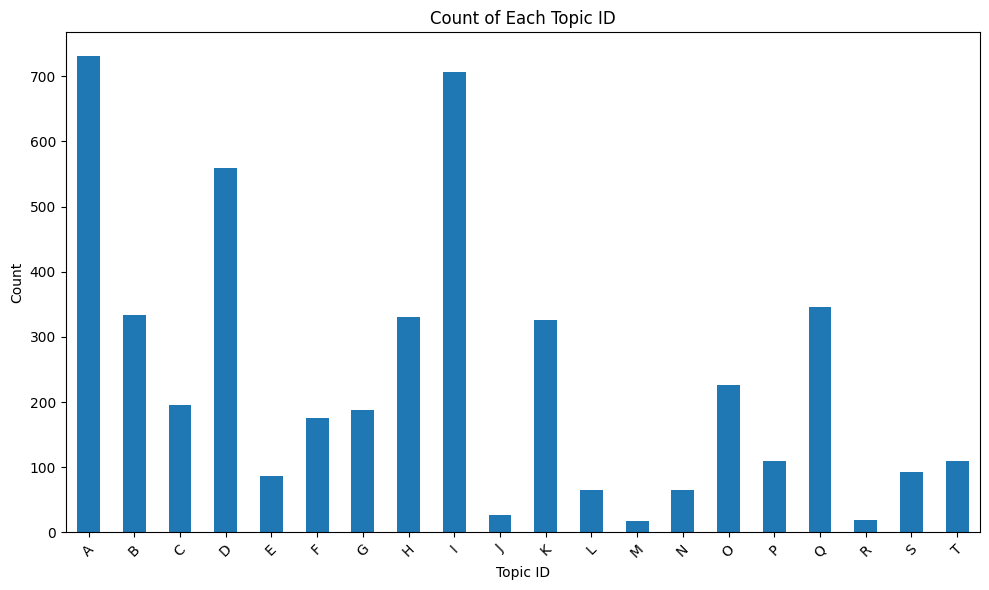

In [107]:
topic_id_counts = final_df['topic_id'].value_counts().sort_index()
plt.figure(figsize=(10, 6))
topic_id_counts.plot(kind='bar')
plt.xlabel('Topic ID')
plt.ylabel('Count')
plt.title('Count of Each Topic ID')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

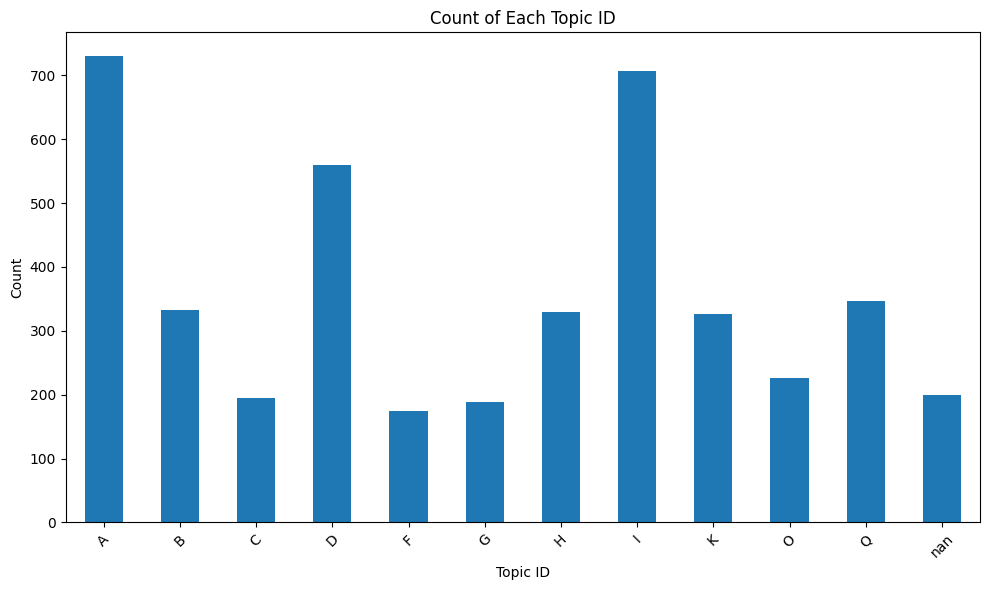

In [121]:
# Getting the value counts
value_counts = final_df['topic_id'].value_counts()

# Taking topics classified more than 150 times
frequent_topics = value_counts[value_counts > 150].index.tolist()

# Filtering the dataframe for these topics and NaN values
filtered_df = final_df[final_df['topic_id'].isin(frequent_topics) | final_df['topic_id'].isna()]

# Taking 200 records of NaN values
nan_records = filtered_df[filtered_df['topic_id'].isna()].head(200)

# Combining the frequent topics and the NaN records
result_df = pd.concat([filtered_df[filtered_df['topic_id'].isin(frequent_topics)], nan_records])

# Count the distribution after removing topics
topic_id_counts = result_df['topic_id'].value_counts(dropna=False).sort_index()

# Plot the new disribuution
plt.figure(figsize=(10, 6))
topic_id_counts.plot(kind='bar')
plt.xlabel('Topic ID')
plt.ylabel('Count')
plt.title('Count of Each Topic ID')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

In [132]:
# Given list of topics
topics = [
    'Military Operations in Gaza',
    'Judicial Reform and its Implications',
    'Public Sentiment on Government Policies',
    'Political Accountability in Israel',
    'Humanitarian Concerns in Conflict Zones',
    'Media Representation of War Events',
    'Public Protests Against Government Actions',
    'Civil-Military Relations in Israel',
    'Impact of Supreme Court Decisions on Governance',
    'Public Opinion on Military Actions in Gaza',
    'Public Opinion on Political Leadership',
    'Humanitarian Issues in Conflict Zones',
    'Media Coverage of Military Operations',
    'Public Opinion on Judicial Authority',
    'Impact of Military Actions on Civilian Life',
    'International Response to the Gaza Conflict',
    'Public Opinion on Judicial Reform',
    'Public Opinion on Government Accountability',
    'Public Discourse on National Security',
    'Public Opinion on the Israeli-Palestinian Conflict'
]

# Create a dataframe for the topics with alphabetical IDs
topics_df = pd.DataFrame({
    'topic_id': list(string.ascii_uppercase[:len(topics)]),
    'topic': topics
})

# Merge the topics dataframe with the result_df by the column 'topic_id'
merged_df = pd.merge(result_df, topics_df, on='topic_id', how='left')

merged_df[["Lemmatized Cleaned Text", "topic_id", "topic"]].head()

,Lemmatized Cleaned Text,topic_id,topic
0,א התפלא נלחם רגע ב הזכיר רגע זמן הוא יוצא מגדר...,K,Public Opinion on Political Leadership
1,א חייב להיות גבול שבו ערוך ב שים לב רגע נמנע מ...,A,Military Operations in Gaza
2,א י ז ה כ י ע ו ר מערכה משפט מסוגל הפציץ בית נ...,B,Judicial Reform and its Implications
3,א יכול להיות ימני שורה חסיד מפלגה אדם ספציפי ג...,D,Political Accountability in Israel
4,א לא עז ב אמצע מסע הרג יישוב יהודי ג אומר מצב ...,A,Military Operations in Gaza


In [135]:
merged_df[['topic_id', 'topic']].value_counts(dropna=False)

topic_id  topic                                          
A         Military Operations in Gaza                        731
I         Impact of Supreme Court Decisions on Governance    707
D         Political Accountability in Israel                 560
Q         Public Opinion on Judicial Reform                  346
B         Judicial Reform and its Implications               333
H         Civil-Military Relations in Israel                 330
K         Public Opinion on Political Leadership             326
O         Impact of Military Actions on Civilian Life        226
NaN       NaN                                                200
C         Public Sentiment on Government Policies            195
G         Public Protests Against Government Actions         188
F         Media Representation of War Events                 175
Name: count, dtype: int64

In [133]:
# Specify the filename
filename = folder_path + 'dataset.csv'

# Save the dataframe to a CSV file
merged_df.to_csv(filename, index=False)

We see that the first few topics were classified more frequently compared to the others, which reflects the model's behavior. Subsequently, we filtered out records with fewer than 150 occurrences and retained 200 records with errors. As a result, we now have an unbalanced dataset of texts.

If this were in production, I would continue by organizing the texts and prompts further, taking into account the timestamps of each tweet.

Given that this is an exercise, I will proceed.

## Recap of Our Mission

We just finished to identify key topics from Twitter tweets.

Also I planned to, we don't need to train a classification model. What we've done so far is good enough for this exercise.

> An executable Python script that reads the CSV file and returns a list of top topics.

I was planning to fine-tune the DictaBERT model for topic classification, but now I see it's not needed.
We will use the classification dataset we did above to analyse our generated topics.

My next step is putting together a script that sums up the work so I would be ablt to run it on my local machines.


The `main.py` script processes a lemmatized dataset to extract key topics in Hebrew with just a single click. It allows for the tuning of `batch_size` and `num_batches` hyperparameters based on specific needs.